In [69]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt


from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB

In [70]:
df = pd.read_csv('data.csv')
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [71]:
df.tail()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN
568,92751,B,7.76,24.54,47.92,181.0,0.05263,0.04362,0.00000,0.00000,...,30.37,59.16,268.6,0.08996,0.06444,0.0000,0.0000,0.2871,0.07039,NaN


In [72]:
df.shape

(569, 33)

In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [74]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
id,569.0,3.037183e+07,1.250206e+08,8670.000000,869218.000000,906024.000000,8.813129e+06,9.113205e+08
radius_mean,569.0,1.412729e+01,3.524049e+00,6.981000,11.700000,13.370000,1.578000e+01,2.811000e+01
texture_mean,569.0,1.928965e+01,4.301036e+00,9.710000,16.170000,18.840000,2.180000e+01,3.928000e+01
perimeter_mean,569.0,9.196903e+01,2.429898e+01,43.790000,75.170000,86.240000,1.041000e+02,1.885000e+02
area_mean,569.0,6.548891e+02,3.519141e+02,143.500000,420.300000,551.100000,7.827000e+02,2.501000e+03
smoothness_mean,569.0,9.636028e-02,1.406413e-02,0.052630,0.086370,0.095870,1.053000e-01,1.634000e-01
compactness_mean,569.0,1.043410e-01,5.281276e-02,0.019380,0.064920,0.092630,1.304000e-01,3.454000e-01
concavity_mean,569.0,8.879932e-02,7.971981e-02,0.000000,0.029560,0.061540,1.307000e-01,4.268000e-01
concave points_mean,569.0,4.891915e-02,3.880284e-02,0.000000,0.020310,0.033500,7.400000e-02,2.012000e-01
symmetry_mean,569.0,1.811619e-01,2.741428e-02,0.106000,0.161900,0.179200,1.957000e-01,3.040000e-01


In [75]:
df.isna().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [76]:
df['diagnosis'].value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

<AxesSubplot: xlabel='diagnosis', ylabel='count'>

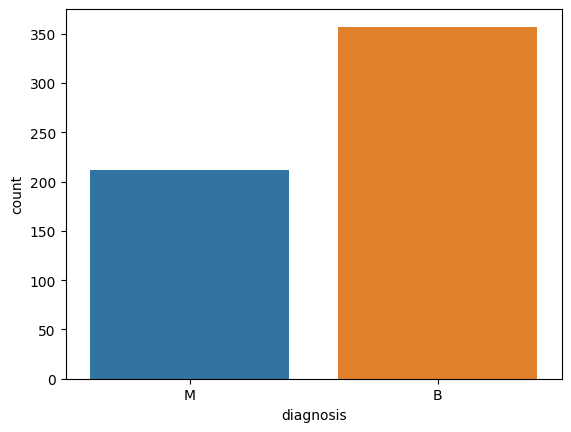

In [77]:
sns.countplot(df, x= 'diagnosis')

In [78]:
df.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

In [79]:
df.drop(['Unnamed: 32'] , axis = 1, inplace = True)

In [80]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [81]:
df['diagnosis'].replace({"M":1, 'B':0}, inplace = True)

<AxesSubplot: xlabel='diagnosis', ylabel='count'>

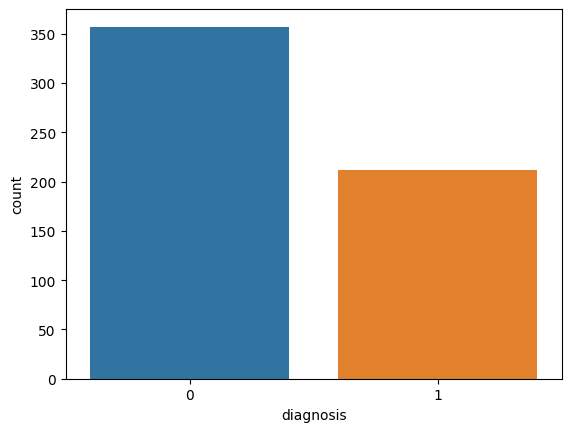

In [82]:
sns.countplot(df, x = "diagnosis")

<AxesSubplot: >

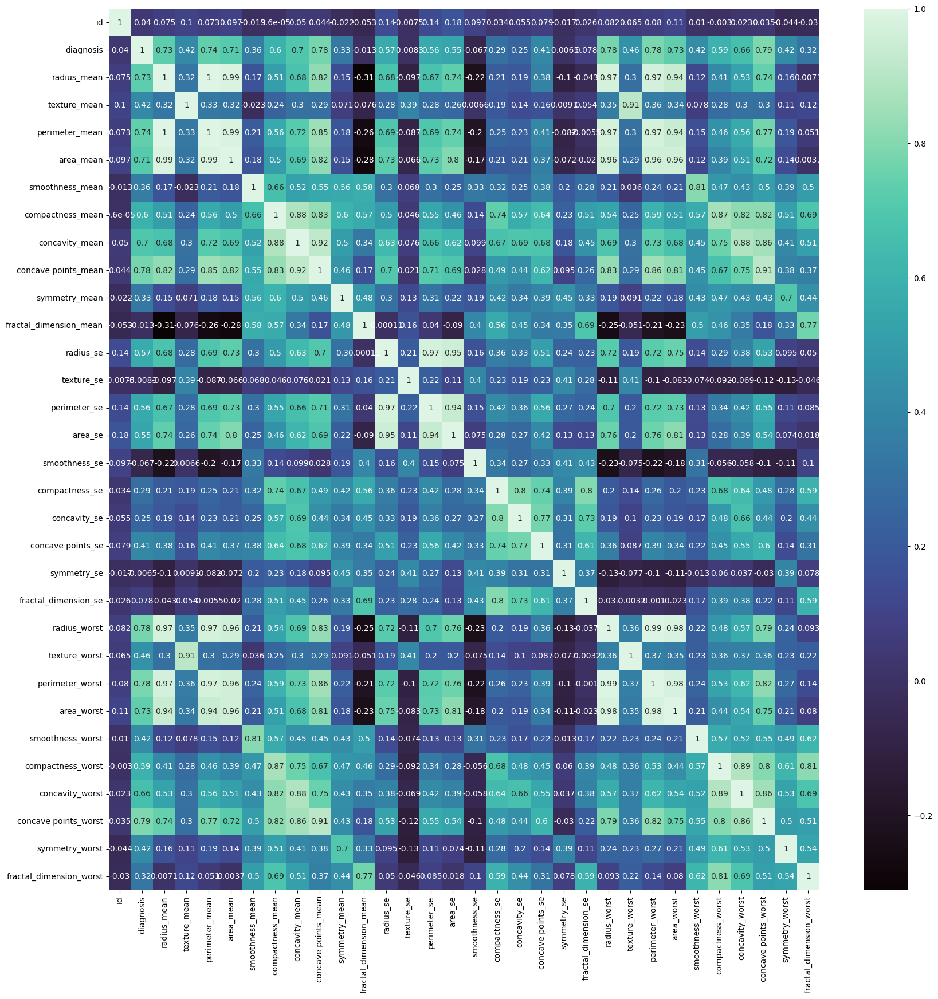

In [83]:
plt.figure(figsize = (20, 20))
sns.heatmap(df.corr(), annot = True, cmap = 'mako')

In [109]:
sns.pairplot(df, hue="diagnosis")

### Split Dataset

In [85]:
X = df.drop(['diagnosis'], axis = 1)
y = df['diagnosis']

In [86]:
X_train, X_test, y_train , y_test = train_test_split(X, y, random_state = 101, test_size = 0.3)

In [87]:
print(X_train.shape)
print(X_test.shape)

(398, 31)
(171, 31)


In [88]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.fit_transform(X_test)

In [89]:
model = LogisticRegression()
model.fit(X_train, y_train)
predict = model.predict(X_test)

plot confusion matrix {true positive , true negative , false positive , flase negative }

Confusion Matrix


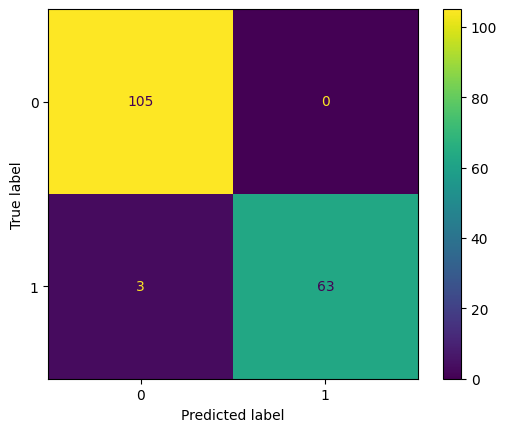

In [90]:
print('Confusion Matrix')
cm = confusion_matrix(y_test, predict)
c = ConfusionMatrixDisplay(cm)
c.plot()
plt.show()

Calculate Accuracy

In [91]:
print('Confusion Matrix', cm)
print(classification_report(y_test, predict))
print('Accuracy = ', accuracy_score(y_test, predict))

Confusion Matrix [[105   0]
 [  3  63]]
              precision    recall  f1-score   support

           0       0.97      1.00      0.99       105
           1       1.00      0.95      0.98        66

    accuracy                           0.98       171
   macro avg       0.99      0.98      0.98       171
weighted avg       0.98      0.98      0.98       171

Accuracy =  0.9824561403508771


In [92]:
model  = KNeighborsClassifier()
model.fit(X_train, y_train)

KNeighborsClassifier()

In [93]:
predict = model.predict(X_test)

Confusion Matrix


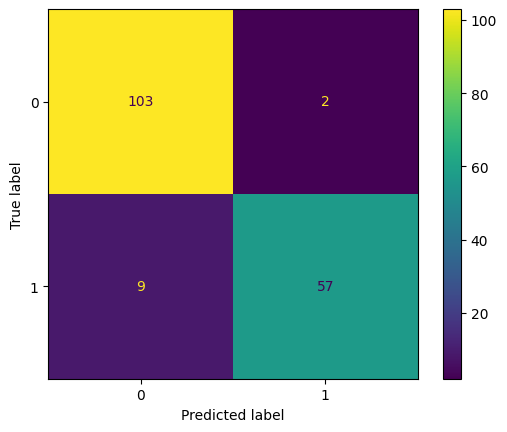

In [94]:
print('Confusion Matrix')
cm = confusion_matrix(y_test, predict)
c = ConfusionMatrixDisplay(cm)
c.plot()
plt.show()

In [95]:
print('Confusion Matrix', cm)
print(classification_report(y_test, predict))
print('Accuracy = ', accuracy_score(y_test, predict))

Confusion Matrix [[103   2]
 [  9  57]]
              precision    recall  f1-score   support

           0       0.92      0.98      0.95       105
           1       0.97      0.86      0.91        66

    accuracy                           0.94       171
   macro avg       0.94      0.92      0.93       171
weighted avg       0.94      0.94      0.93       171

Accuracy =  0.935672514619883


Using another model to classify
**RandomForestClassifier**

In [96]:
model = RandomForestClassifier(random_state=0)
model.fit(X_train, y_train)
predict = model.predict(X_test)

Confusion Matrix


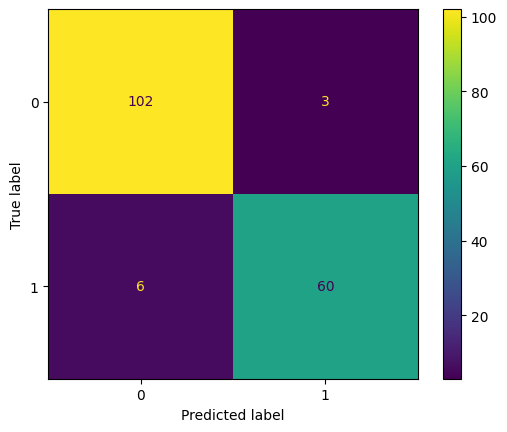

In [97]:
print('Confusion Matrix')
cm = confusion_matrix(y_test, predict)
c = ConfusionMatrixDisplay(cm)
c.plot()
plt.show()

In [98]:
print('Confusion Matrix', cm)
print(classification_report(y_test, predict))
print('Accuracy = ', accuracy_score(y_test, predict))

Confusion Matrix [[102   3]
 [  6  60]]
              precision    recall  f1-score   support

           0       0.94      0.97      0.96       105
           1       0.95      0.91      0.93        66

    accuracy                           0.95       171
   macro avg       0.95      0.94      0.94       171
weighted avg       0.95      0.95      0.95       171

Accuracy =  0.9473684210526315


Using another model to classify **DecisionTreeClassifier**

In [99]:
model = DecisionTreeClassifier(random_state=42)
model.fit(X_train, y_train)
predict = model.predict(X_test)

Confusion Matrix


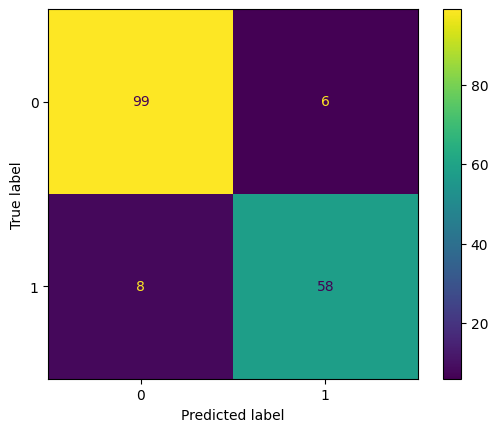

In [100]:
print('Confusion Matrix')
cm = confusion_matrix(y_test, predict)
c = ConfusionMatrixDisplay(cm)
c.plot()
plt.show()

In [101]:
print('Confusion Matrix', cm)
print(classification_report(y_test, predict))
print('Accuracy = ', accuracy_score(y_test, predict))

Confusion Matrix [[99  6]
 [ 8 58]]
              precision    recall  f1-score   support

           0       0.93      0.94      0.93       105
           1       0.91      0.88      0.89        66

    accuracy                           0.92       171
   macro avg       0.92      0.91      0.91       171
weighted avg       0.92      0.92      0.92       171

Accuracy =  0.9181286549707602


Using another model **GuassianNB**

In [105]:
model = GaussianNB()
model.fit(X_train, y_train)
predict = model.predict(X_test)

Confusion Matrix


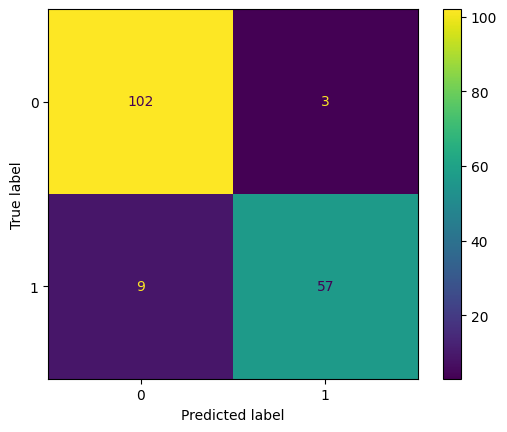

In [107]:
print ("Confusion Matrix")
cm = confusion_matrix(y_test ,predict )
c = ConfusionMatrixDisplay(cm)
c.plot()
plt.show()

In [108]:
print ("Confusion Matrix",cm)
print(classification_report(y_test, predict))
print("Accuracy = ",accuracy_score(y_test, predict))

Confusion Matrix [[102   3]
 [  9  57]]
              precision    recall  f1-score   support

           0       0.92      0.97      0.94       105
           1       0.95      0.86      0.90        66

    accuracy                           0.93       171
   macro avg       0.93      0.92      0.92       171
weighted avg       0.93      0.93      0.93       171

Accuracy =  0.9298245614035088
